<a href="https://colab.research.google.com/github/shivgarg/image-superresolution/blob/master/SRGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
import torch.nn as nn
import torch.nn.functional as F
import torch
from torchvision.models import vgg19
import math
import glob
import random
import os
import numpy as np
from torch.utils.data import Dataset
from PIL import Image
import torchvision.transforms as transforms


class FeatureExtractor(nn.Module):
    def __init__(self):
        super(FeatureExtractor, self).__init__()
        vgg19_model = vgg19(pretrained=True)
        self.feature_extractor = nn.Sequential(*list(vgg19_model.features.children())[:18])

    def forward(self, img):
        return self.feature_extractor(img)


class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()
        self.conv_block = nn.Sequential(
            nn.Conv2d(in_features, in_features, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(in_features, 0.8),
            nn.PReLU(),
            nn.Conv2d(in_features, in_features, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(in_features, 0.8),
        )

    def forward(self, x):
        return x + self.conv_block(x)


class GeneratorResNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=3, n_residual_blocks=16):
        super(GeneratorResNet, self).__init__()

        # First layer
        self.conv1 = nn.Sequential(nn.Conv2d(in_channels, 64, kernel_size=9, stride=1, padding=4), nn.PReLU())

        # Residual blocks
        res_blocks = []
        for _ in range(n_residual_blocks):
            res_blocks.append(ResidualBlock(64))
        self.res_blocks = nn.Sequential(*res_blocks)

        # Second conv layer post residual blocks
        self.conv2 = nn.Sequential(nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1), nn.BatchNorm2d(64, 0.8))

        # Upsampling layers
        upsampling = []
        for out_features in range(2):
            upsampling += [
                # nn.Upsample(scale_factor=2),
                nn.Conv2d(64, 256, 3, 1, 1),
                nn.BatchNorm2d(256),
                nn.PixelShuffle(upscale_factor=2),
                nn.PReLU(),
            ]
        self.upsampling = nn.Sequential(*upsampling)

        # Final output layer
        self.conv3 = nn.Sequential(nn.Conv2d(64, out_channels, kernel_size=9, stride=1, padding=4), nn.Tanh())

    def forward(self, x):
        out1 = self.conv1(x)
        out = self.res_blocks(out1)
        out2 = self.conv2(out)
        out = torch.add(out1, out2)
        out = self.upsampling(out)
        out = self.conv3(out)
        return out


class Discriminator(nn.Module):
    def __init__(self, input_shape):
        super(Discriminator, self).__init__()

        self.input_shape = input_shape
        in_channels, in_height, in_width = self.input_shape
        patch_h, patch_w = int(in_height / 2 ** 4), int(in_width / 2 ** 4)
        self.output_shape = (1, patch_h, patch_w)

        def discriminator_block(in_filters, out_filters, first_block=False):
            layers = []
            layers.append(nn.Conv2d(in_filters, out_filters, kernel_size=3, stride=1, padding=1))
            if not first_block:
                layers.append(nn.BatchNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            layers.append(nn.Conv2d(out_filters, out_filters, kernel_size=3, stride=2, padding=1))
            layers.append(nn.BatchNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        layers = []
        in_filters = in_channels
        for i, out_filters in enumerate([64, 128, 256, 512]):
            layers.extend(discriminator_block(in_filters, out_filters, first_block=(i == 0)))
            in_filters = out_filters

        layers.append(nn.Conv2d(out_filters, 1, kernel_size=3, stride=1, padding=1))

        self.model = nn.Sequential(*layers)

    def forward(self, img):
        return self.model(img)
# Normalization parameters for pre-trained PyTorch models


mean = np.array([0.485, 0.456, 0.406])
std = np.array([0.229, 0.224, 0.225])


class ImageDataset(Dataset):
    def __init__(self, root, hr_shape):
        hr_height, hr_width = hr_shape
        # Transforms for low resolution images and high resolution images
        self.lr_transform = transforms.Compose(
            [
                transforms.Resize((hr_height // 4, hr_height // 4), Image.BICUBIC),
                transforms.ToTensor(),
                transforms.Normalize(mean, std),
            ]
        )
        self.hr_transform = transforms.Compose(
            [
                transforms.Resize((hr_height, hr_height), Image.BICUBIC),
                transforms.ToTensor(),
                transforms.Normalize(mean, std),
            ]
        )

        self.files = sorted(glob.glob(root + "/*.*"))

    def __getitem__(self, index):
        img = Image.open(self.files[index % len(self.files)])
        img_lr = self.lr_transform(img)
        img_hr = self.hr_transform(img)

        return {"lr": img_lr, "hr": img_hr}

    def __len__(self):
        return len(self.files)


In [0]:

cuda = torch.cuda.is_available()

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
!unzip -q /content/drive/My\ Drive/DL_Seminar/256x256.zip -d /data

In [0]:
hr_shape = (256, 256)

# Initialize generator and discriminator
generator = GeneratorResNet()
discriminator = Discriminator(input_shape=(3, *hr_shape))
feature_extractor = FeatureExtractor()

# Set feature extractor to inference mode
feature_extractor.eval()

# Losses
criterion_GAN = torch.nn.MSELoss()
criterion_content = torch.nn.L1Loss()

if cuda:
    generator = generator.cuda()
    discriminator = discriminator.cuda()
    feature_extractor = feature_extractor.cuda()
    criterion_GAN = criterion_GAN.cuda()
    criterion_content = criterion_content.cuda()

#if opt.epoch != 0:
    # Load pretrained models
#    generator.load_state_dict(torch.load("saved_models/generator_%d.pth"))
#    discriminator.load_state_dict(torch.load("saved_models/discriminator_%d.pth"))

# Optimizers

lr = 0.0002
b1 = 0.5
b2 = 0.999
batch_size = 4
epochs = 200
checkpoint_interval = 1

optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr, betas=(b1, b2))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(b1, b2))

Tensor = torch.cuda.FloatTensor if cuda else torch.Tensor

dataloader = DataLoader(
    ImageDataset("/data/256x256", hr_shape=hr_shape),
    batch_size=batch_size,
    shuffle=True,
    num_workers=4
)

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 574673361/574673361 [00:05<00:00, 106549692.18it/s]


[Epoch 0/200] [Batch 0/9375] [D loss: 0.614536] [G loss: 1.317043]


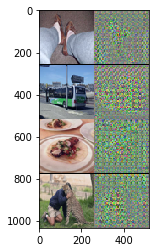

[Epoch 0/200] [Batch 200/9375] [D loss: 0.003833] [G loss: 1.176371]


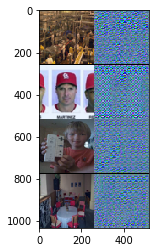

[Epoch 0/200] [Batch 400/9375] [D loss: 0.000895] [G loss: 1.149809]


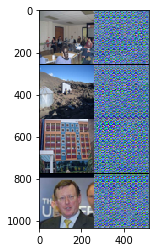

[Epoch 0/200] [Batch 600/9375] [D loss: 0.001009] [G loss: 1.188372]


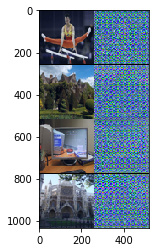

[Epoch 0/200] [Batch 800/9375] [D loss: 0.000952] [G loss: 1.352130]


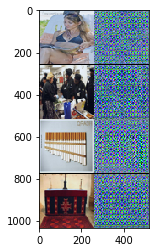

[Epoch 0/200] [Batch 1000/9375] [D loss: 0.001489] [G loss: 1.011934]


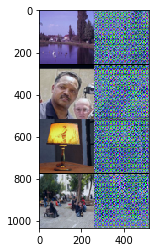

[Epoch 0/200] [Batch 1200/9375] [D loss: 0.000638] [G loss: 1.264175]


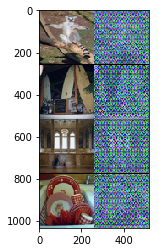

[Epoch 0/200] [Batch 1400/9375] [D loss: 0.001894] [G loss: 0.733320]


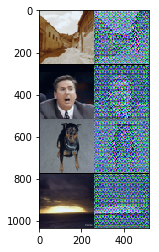

[Epoch 0/200] [Batch 1600/9375] [D loss: 0.000615] [G loss: 1.152366]


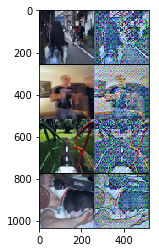

[Epoch 0/200] [Batch 1800/9375] [D loss: 0.022085] [G loss: 0.917972]


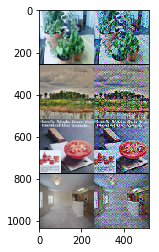

[Epoch 0/200] [Batch 2000/9375] [D loss: 0.001090] [G loss: 0.757389]


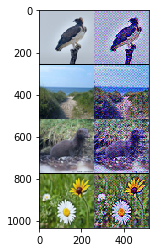

[Epoch 0/200] [Batch 2200/9375] [D loss: 0.000226] [G loss: 1.034260]


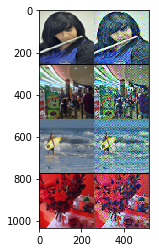

[Epoch 0/200] [Batch 2400/9375] [D loss: 0.000648] [G loss: 0.749614]


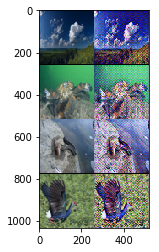

[Epoch 0/200] [Batch 2600/9375] [D loss: 0.000458] [G loss: 0.972125]


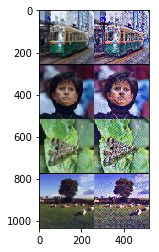

[Epoch 0/200] [Batch 2800/9375] [D loss: 0.000424] [G loss: 0.924373]


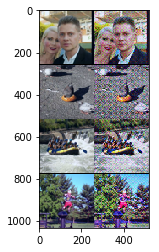

[Epoch 0/200] [Batch 3000/9375] [D loss: 0.000302] [G loss: 1.043356]


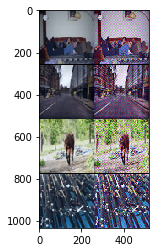

[Epoch 0/200] [Batch 3200/9375] [D loss: 0.001134] [G loss: 0.777340]


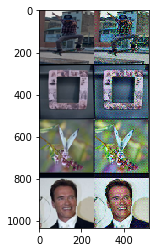

[Epoch 0/200] [Batch 3400/9375] [D loss: 0.000788] [G loss: 0.866653]


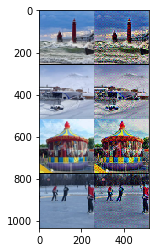

[Epoch 0/200] [Batch 3600/9375] [D loss: 0.001664] [G loss: 1.069734]


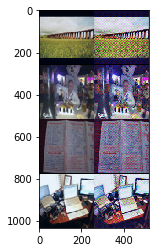

[Epoch 0/200] [Batch 3800/9375] [D loss: 0.000139] [G loss: 0.871213]


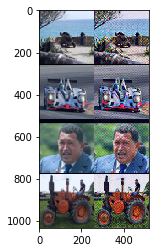

[Epoch 0/200] [Batch 4000/9375] [D loss: 0.000206] [G loss: 0.955011]


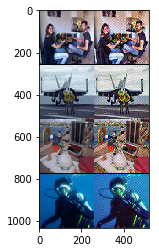

[Epoch 0/200] [Batch 4200/9375] [D loss: 0.000627] [G loss: 0.977879]


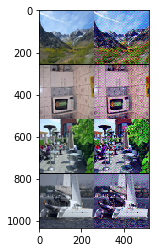

[Epoch 0/200] [Batch 4400/9375] [D loss: 0.000830] [G loss: 0.991409]


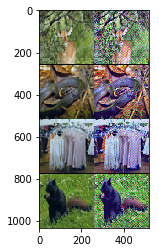

[Epoch 0/200] [Batch 4600/9375] [D loss: 0.001131] [G loss: 0.806836]


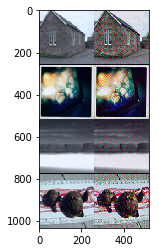

[Epoch 0/200] [Batch 4800/9375] [D loss: 0.000383] [G loss: 1.073747]


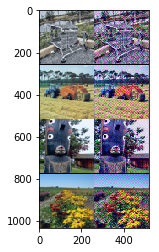

[Epoch 0/200] [Batch 5000/9375] [D loss: 0.000232] [G loss: 1.017133]


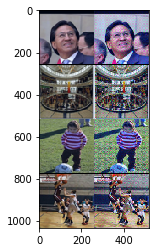

[Epoch 0/200] [Batch 5200/9375] [D loss: 0.000252] [G loss: 0.975135]


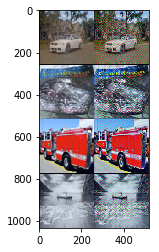

[Epoch 0/200] [Batch 5400/9375] [D loss: 0.001517] [G loss: 1.002119]


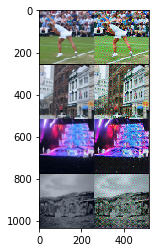

[Epoch 0/200] [Batch 5600/9375] [D loss: 0.000927] [G loss: 0.873846]


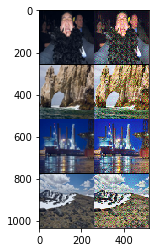

[Epoch 0/200] [Batch 5800/9375] [D loss: 0.002880] [G loss: 1.046655]


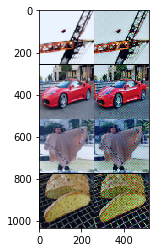

[Epoch 0/200] [Batch 6000/9375] [D loss: 0.000252] [G loss: 0.754605]


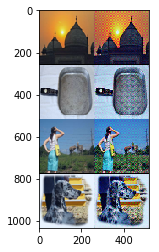

[Epoch 0/200] [Batch 6200/9375] [D loss: 0.000131] [G loss: 0.910612]


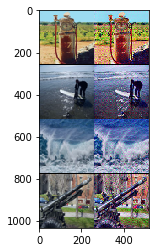

[Epoch 0/200] [Batch 6400/9375] [D loss: 0.001748] [G loss: 0.815722]


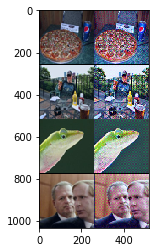

[Epoch 0/200] [Batch 6600/9375] [D loss: 0.000432] [G loss: 0.880556]


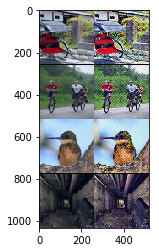

[Epoch 0/200] [Batch 6800/9375] [D loss: 0.000397] [G loss: 0.945863]


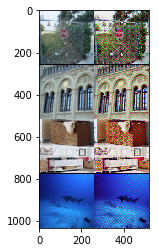

[Epoch 0/200] [Batch 7000/9375] [D loss: 0.000370] [G loss: 0.909858]


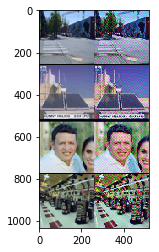

[Epoch 0/200] [Batch 7200/9375] [D loss: 0.001405] [G loss: 0.923800]


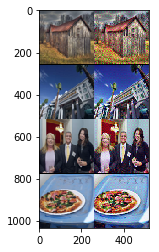

[Epoch 0/200] [Batch 7400/9375] [D loss: 0.000751] [G loss: 0.950333]


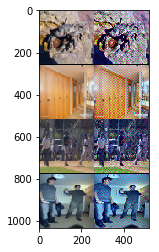

[Epoch 0/200] [Batch 7600/9375] [D loss: 0.000070] [G loss: 0.713340]


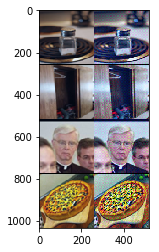

[Epoch 0/200] [Batch 7800/9375] [D loss: 0.000249] [G loss: 1.023407]


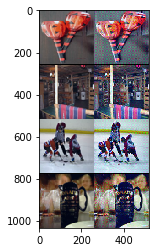

[Epoch 0/200] [Batch 8000/9375] [D loss: 0.000174] [G loss: 0.763903]


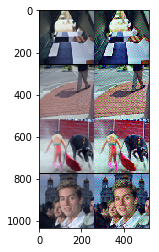

[Epoch 0/200] [Batch 8200/9375] [D loss: 0.000618] [G loss: 1.015267]


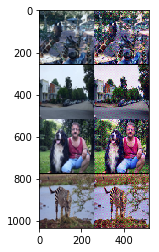

[Epoch 0/200] [Batch 8400/9375] [D loss: 0.000275] [G loss: 0.799610]


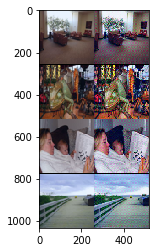

[Epoch 0/200] [Batch 8600/9375] [D loss: 0.000273] [G loss: 0.748777]


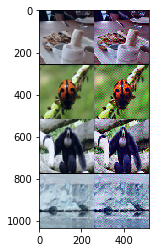

[Epoch 0/200] [Batch 8800/9375] [D loss: 0.000208] [G loss: 0.907686]


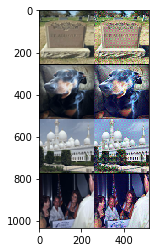

[Epoch 0/200] [Batch 9000/9375] [D loss: 0.000214] [G loss: 1.047955]


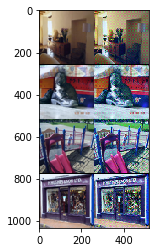

[Epoch 0/200] [Batch 9200/9375] [D loss: 0.000061] [G loss: 0.636375]


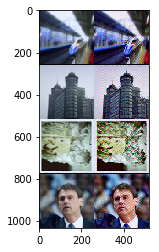

[Epoch 1/200] [Batch 25/9375] [D loss: 0.000393] [G loss: 0.697650]


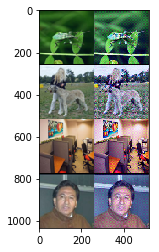

[Epoch 1/200] [Batch 225/9375] [D loss: 0.004036] [G loss: 1.021421]


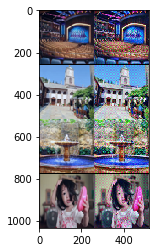

[Epoch 1/200] [Batch 425/9375] [D loss: 0.001134] [G loss: 0.894908]


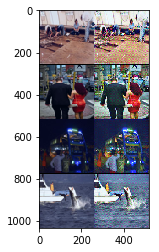

[Epoch 1/200] [Batch 625/9375] [D loss: 0.000535] [G loss: 1.054885]


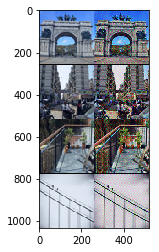

[Epoch 1/200] [Batch 825/9375] [D loss: 0.000122] [G loss: 0.960663]


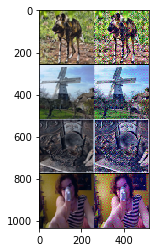

[Epoch 1/200] [Batch 1025/9375] [D loss: 0.000097] [G loss: 0.967678]


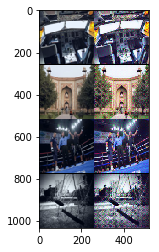

[Epoch 1/200] [Batch 1225/9375] [D loss: 0.000199] [G loss: 0.872090]


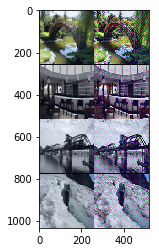

[Epoch 1/200] [Batch 1425/9375] [D loss: 0.000224] [G loss: 0.908211]


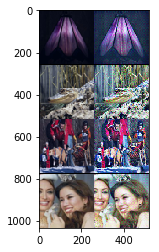

[Epoch 1/200] [Batch 1625/9375] [D loss: 0.000098] [G loss: 1.056704]


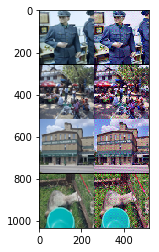

[Epoch 1/200] [Batch 1825/9375] [D loss: 0.000056] [G loss: 0.736672]


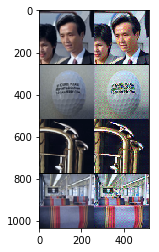

[Epoch 1/200] [Batch 2025/9375] [D loss: 0.000444] [G loss: 0.874914]


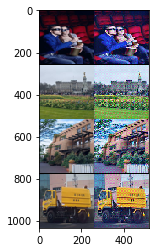

[Epoch 1/200] [Batch 2225/9375] [D loss: 0.000390] [G loss: 0.800964]


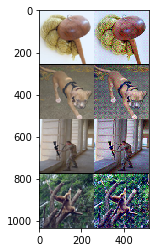

[Epoch 1/200] [Batch 2425/9375] [D loss: 0.000129] [G loss: 0.901760]


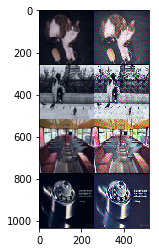

[Epoch 1/200] [Batch 2625/9375] [D loss: 0.000123] [G loss: 0.872463]


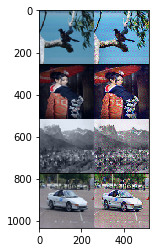

[Epoch 1/200] [Batch 2825/9375] [D loss: 0.000461] [G loss: 0.888136]


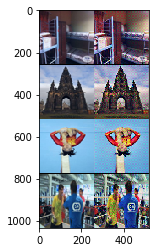

[Epoch 1/200] [Batch 3025/9375] [D loss: 0.000202] [G loss: 0.814752]


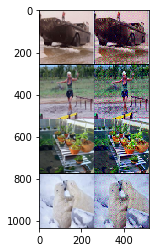

[Epoch 1/200] [Batch 3225/9375] [D loss: 0.000353] [G loss: 0.820158]


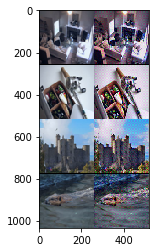

[Epoch 1/200] [Batch 3425/9375] [D loss: 0.000726] [G loss: 0.859036]


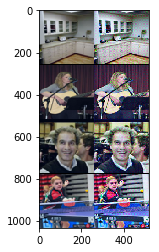

[Epoch 1/200] [Batch 3625/9375] [D loss: 0.000369] [G loss: 0.734476]


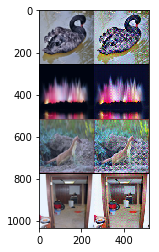

[Epoch 1/200] [Batch 3825/9375] [D loss: 0.000397] [G loss: 0.907692]


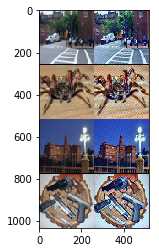

[Epoch 1/200] [Batch 4025/9375] [D loss: 0.000092] [G loss: 0.917862]


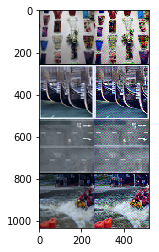

[Epoch 1/200] [Batch 4225/9375] [D loss: 0.000074] [G loss: 0.980907]


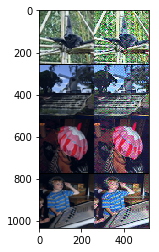

[Epoch 1/200] [Batch 4425/9375] [D loss: 0.000194] [G loss: 1.001717]


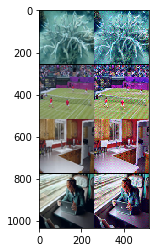

[Epoch 1/200] [Batch 4625/9375] [D loss: 0.000162] [G loss: 0.803556]


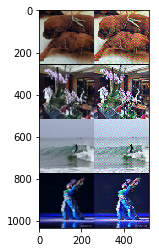

[Epoch 1/200] [Batch 4825/9375] [D loss: 0.000236] [G loss: 0.932159]


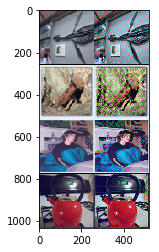

[Epoch 1/200] [Batch 5025/9375] [D loss: 0.000240] [G loss: 0.851062]


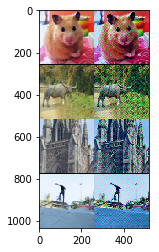

[Epoch 1/200] [Batch 5225/9375] [D loss: 0.000231] [G loss: 0.964738]


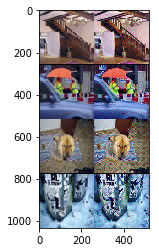

[Epoch 1/200] [Batch 5425/9375] [D loss: 0.000069] [G loss: 0.710160]


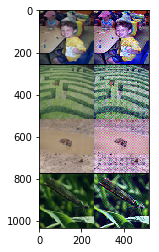

[Epoch 1/200] [Batch 5625/9375] [D loss: 0.000223] [G loss: 0.912791]


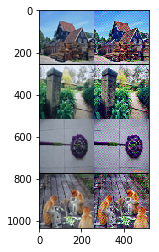

[Epoch 1/200] [Batch 5825/9375] [D loss: 0.004257] [G loss: 0.770454]


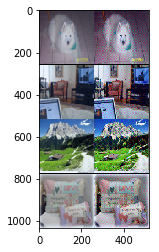

[Epoch 1/200] [Batch 6025/9375] [D loss: 0.000240] [G loss: 1.143636]


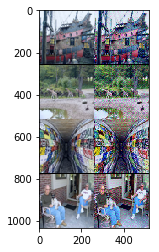

[Epoch 1/200] [Batch 6225/9375] [D loss: 0.000138] [G loss: 0.798587]


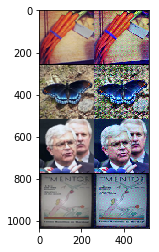

[Epoch 1/200] [Batch 6425/9375] [D loss: 0.000262] [G loss: 0.709455]


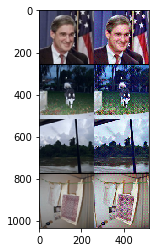

[Epoch 1/200] [Batch 6625/9375] [D loss: 0.000131] [G loss: 1.050004]


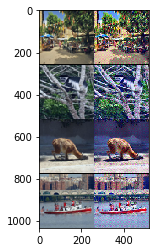

[Epoch 1/200] [Batch 6825/9375] [D loss: 0.000082] [G loss: 1.051109]


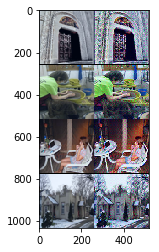

[Epoch 1/200] [Batch 7025/9375] [D loss: 0.000068] [G loss: 0.882322]


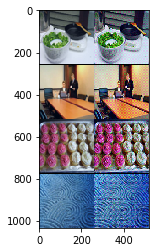

[Epoch 1/200] [Batch 7225/9375] [D loss: 0.000069] [G loss: 0.681393]


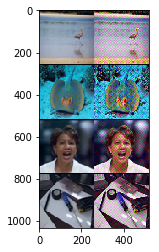

[Epoch 1/200] [Batch 7425/9375] [D loss: 0.000069] [G loss: 0.867049]


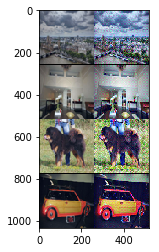

[Epoch 1/200] [Batch 7625/9375] [D loss: 0.000923] [G loss: 0.853142]


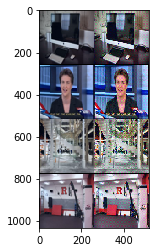

[Epoch 1/200] [Batch 7825/9375] [D loss: 0.000233] [G loss: 0.799463]


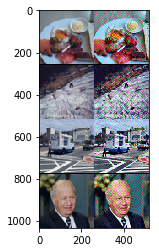

[Epoch 1/200] [Batch 8025/9375] [D loss: 0.000037] [G loss: 0.748079]


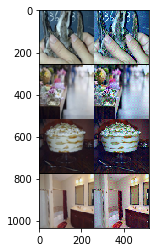

[Epoch 1/200] [Batch 8225/9375] [D loss: 0.000042] [G loss: 0.625464]


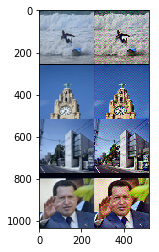

[Epoch 1/200] [Batch 8425/9375] [D loss: 0.000114] [G loss: 1.293685]


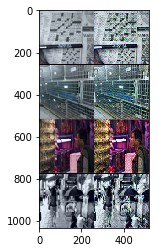

[Epoch 1/200] [Batch 8625/9375] [D loss: 0.000142] [G loss: 0.661760]


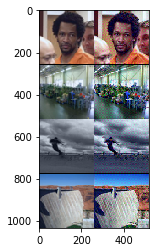

[Epoch 1/200] [Batch 8825/9375] [D loss: 0.000239] [G loss: 0.994223]


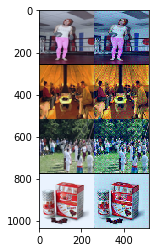

[Epoch 1/200] [Batch 9025/9375] [D loss: 0.000076] [G loss: 0.904644]


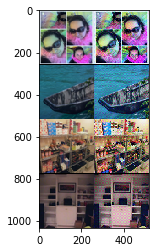

[Epoch 1/200] [Batch 9225/9375] [D loss: 0.000424] [G loss: 0.923149]


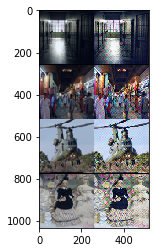

[Epoch 2/200] [Batch 50/9375] [D loss: 0.000093] [G loss: 0.893560]


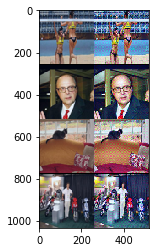

[Epoch 2/200] [Batch 250/9375] [D loss: 0.000122] [G loss: 0.837860]


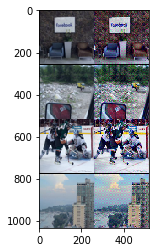

[Epoch 2/200] [Batch 450/9375] [D loss: 0.000107] [G loss: 0.941427]


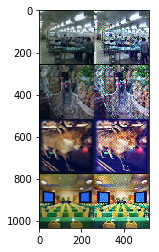

[Epoch 2/200] [Batch 650/9375] [D loss: 0.000095] [G loss: 0.809305]


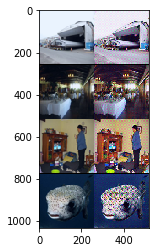

[Epoch 2/200] [Batch 850/9375] [D loss: 0.000166] [G loss: 0.902712]


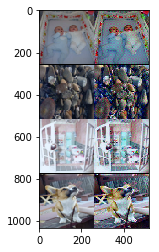

[Epoch 2/200] [Batch 1050/9375] [D loss: 0.000070] [G loss: 0.825480]


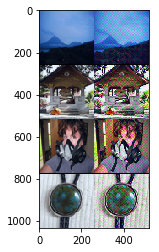

[Epoch 2/200] [Batch 1250/9375] [D loss: 0.000195] [G loss: 1.033726]


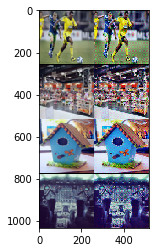

[Epoch 2/200] [Batch 1450/9375] [D loss: 0.000584] [G loss: 0.818358]


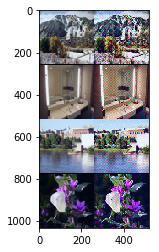

[Epoch 2/200] [Batch 1650/9375] [D loss: 0.000140] [G loss: 0.838309]


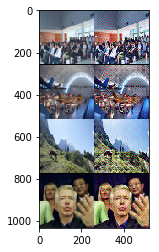

[Epoch 2/200] [Batch 1850/9375] [D loss: 0.000230] [G loss: 0.767848]


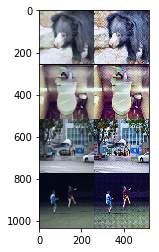

[Epoch 2/200] [Batch 2050/9375] [D loss: 0.000130] [G loss: 0.860641]


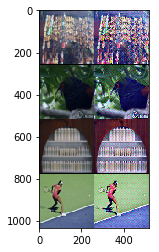

[Epoch 2/200] [Batch 2250/9375] [D loss: 0.000143] [G loss: 0.605091]


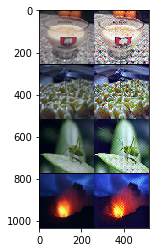

[Epoch 2/200] [Batch 2450/9375] [D loss: 0.000218] [G loss: 0.727255]


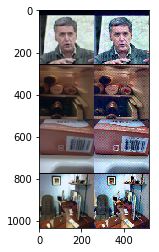

[Epoch 2/200] [Batch 2650/9375] [D loss: 0.000074] [G loss: 0.710142]


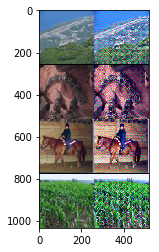

[Epoch 2/200] [Batch 2850/9375] [D loss: 0.000020] [G loss: 0.897782]


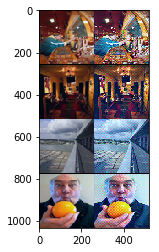

[Epoch 2/200] [Batch 3050/9375] [D loss: 0.000158] [G loss: 0.822390]


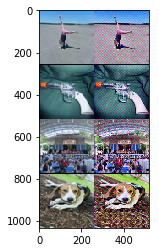

[Epoch 2/200] [Batch 3250/9375] [D loss: 0.000091] [G loss: 0.691016]


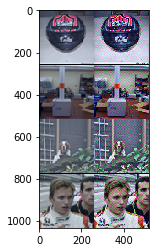

[Epoch 2/200] [Batch 3450/9375] [D loss: 0.000101] [G loss: 0.749237]


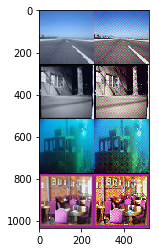

[Epoch 2/200] [Batch 3650/9375] [D loss: 0.000106] [G loss: 0.925900]


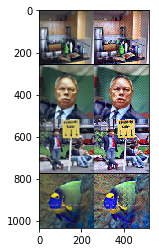

[Epoch 2/200] [Batch 3850/9375] [D loss: 0.000037] [G loss: 0.808298]


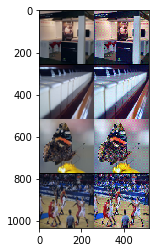

[Epoch 2/200] [Batch 4050/9375] [D loss: 0.000046] [G loss: 0.659995]


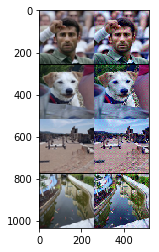

[Epoch 2/200] [Batch 4250/9375] [D loss: 0.000482] [G loss: 0.927715]


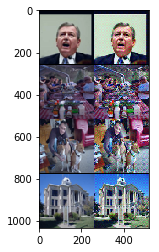

[Epoch 2/200] [Batch 4450/9375] [D loss: 0.000219] [G loss: 0.889551]


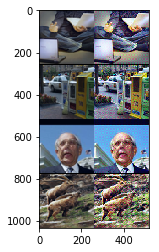

[Epoch 2/200] [Batch 4650/9375] [D loss: 0.000142] [G loss: 0.761020]


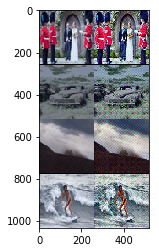

[Epoch 2/200] [Batch 4850/9375] [D loss: 0.000194] [G loss: 0.825057]


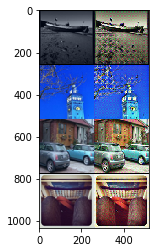

[Epoch 2/200] [Batch 5050/9375] [D loss: 0.000086] [G loss: 0.882087]


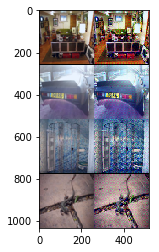

[Epoch 2/200] [Batch 5250/9375] [D loss: 0.000090] [G loss: 0.799431]


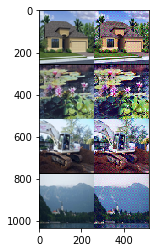

[Epoch 2/200] [Batch 5450/9375] [D loss: 0.000048] [G loss: 0.704357]


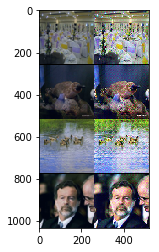

[Epoch 2/200] [Batch 5650/9375] [D loss: 0.000053] [G loss: 0.786957]


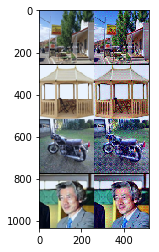

[Epoch 2/200] [Batch 5850/9375] [D loss: 0.000323] [G loss: 1.046964]


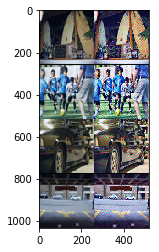

[Epoch 2/200] [Batch 6050/9375] [D loss: 0.000177] [G loss: 0.789933]


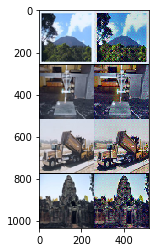

[Epoch 2/200] [Batch 6250/9375] [D loss: 0.000206] [G loss: 0.916942]


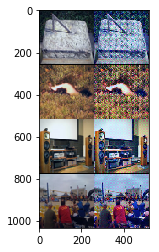

[Epoch 2/200] [Batch 6450/9375] [D loss: 0.000197] [G loss: 0.739479]


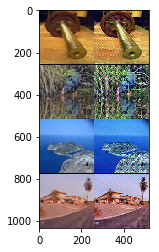

[Epoch 2/200] [Batch 6650/9375] [D loss: 0.000192] [G loss: 0.835508]


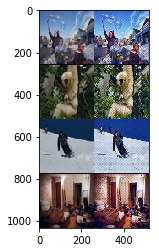

[Epoch 2/200] [Batch 6850/9375] [D loss: 0.000103] [G loss: 0.804971]


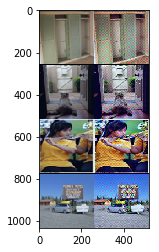

[Epoch 2/200] [Batch 7050/9375] [D loss: 0.000056] [G loss: 0.892506]


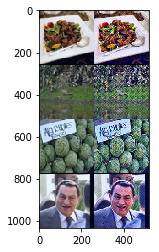

[Epoch 2/200] [Batch 7250/9375] [D loss: 0.000153] [G loss: 0.936076]


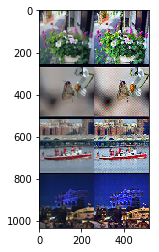

[Epoch 2/200] [Batch 7450/9375] [D loss: 0.000059] [G loss: 0.897293]


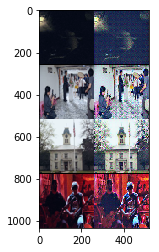

[Epoch 2/200] [Batch 7650/9375] [D loss: 0.000172] [G loss: 0.825105]


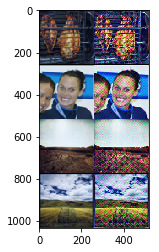

[Epoch 2/200] [Batch 7850/9375] [D loss: 0.000142] [G loss: 0.921690]


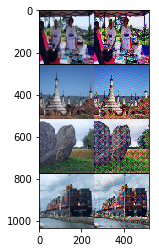

[Epoch 2/200] [Batch 8050/9375] [D loss: 0.000084] [G loss: 0.781807]


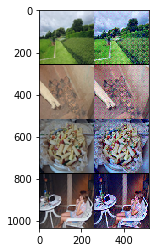

[Epoch 2/200] [Batch 8250/9375] [D loss: 0.000048] [G loss: 0.982443]


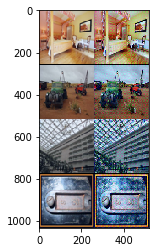

[Epoch 2/200] [Batch 8450/9375] [D loss: 0.000126] [G loss: 1.067399]


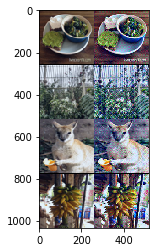

[Epoch 2/200] [Batch 8650/9375] [D loss: 0.000189] [G loss: 0.798135]


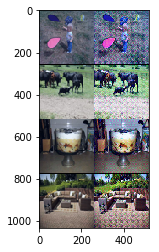

[Epoch 2/200] [Batch 8850/9375] [D loss: 0.000054] [G loss: 0.780671]


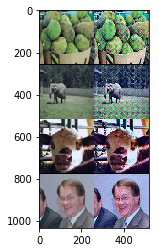

[Epoch 2/200] [Batch 9050/9375] [D loss: 0.000115] [G loss: 0.870618]


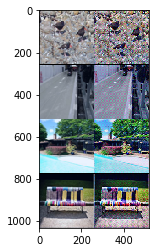

[Epoch 2/200] [Batch 9250/9375] [D loss: 0.000125] [G loss: 0.974052]


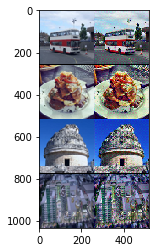

[Epoch 3/200] [Batch 75/9375] [D loss: 0.000072] [G loss: 0.910008]


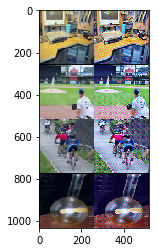

[Epoch 3/200] [Batch 275/9375] [D loss: 0.000153] [G loss: 0.633057]


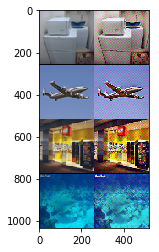

[Epoch 3/200] [Batch 475/9375] [D loss: 0.000220] [G loss: 0.746512]


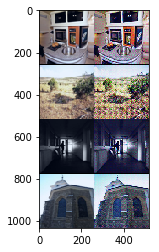

[Epoch 3/200] [Batch 675/9375] [D loss: 0.000028] [G loss: 0.849963]


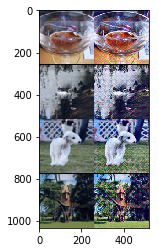

[Epoch 3/200] [Batch 875/9375] [D loss: 0.000037] [G loss: 0.647900]


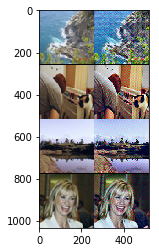

[Epoch 3/200] [Batch 1075/9375] [D loss: 0.000025] [G loss: 0.903886]


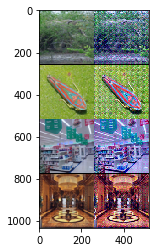

[Epoch 3/200] [Batch 1275/9375] [D loss: 0.000081] [G loss: 0.780120]


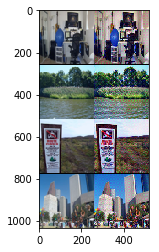

[Epoch 3/200] [Batch 1475/9375] [D loss: 0.000060] [G loss: 0.664407]


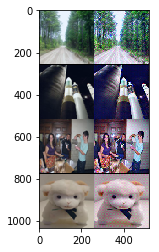

[Epoch 3/200] [Batch 1675/9375] [D loss: 0.000042] [G loss: 0.693693]


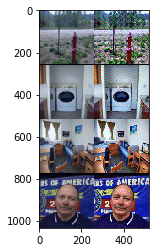

[Epoch 3/200] [Batch 1875/9375] [D loss: 0.000083] [G loss: 0.758030]


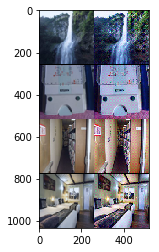

[Epoch 3/200] [Batch 2075/9375] [D loss: 0.000202] [G loss: 1.100034]


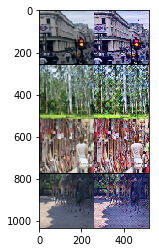

[Epoch 3/200] [Batch 2275/9375] [D loss: 0.000183] [G loss: 0.841048]


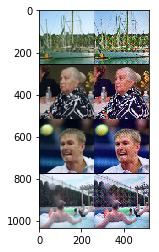

[Epoch 3/200] [Batch 2475/9375] [D loss: 0.000061] [G loss: 1.137516]


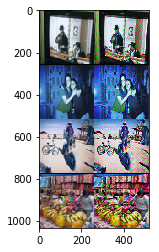

[Epoch 3/200] [Batch 2675/9375] [D loss: 0.000014] [G loss: 1.157064]


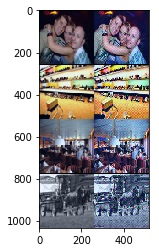

[Epoch 3/200] [Batch 2875/9375] [D loss: 0.000098] [G loss: 0.947862]


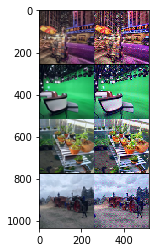

[Epoch 3/200] [Batch 3075/9375] [D loss: 0.000256] [G loss: 0.897677]


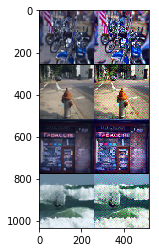

[Epoch 3/200] [Batch 3275/9375] [D loss: 0.000070] [G loss: 0.793689]


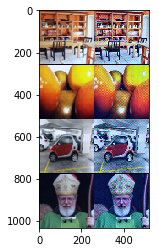

[Epoch 3/200] [Batch 3475/9375] [D loss: 0.000029] [G loss: 0.901515]


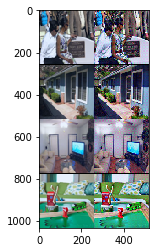

[Epoch 3/200] [Batch 3675/9375] [D loss: 0.000061] [G loss: 0.714841]


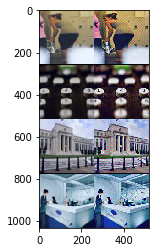

[Epoch 3/200] [Batch 3875/9375] [D loss: 0.000153] [G loss: 0.637953]


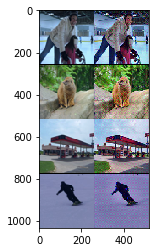

[Epoch 3/200] [Batch 4075/9375] [D loss: 0.000064] [G loss: 0.969684]


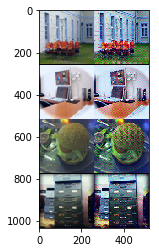

[Epoch 3/200] [Batch 4275/9375] [D loss: 0.000500] [G loss: 0.678722]


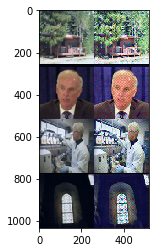

[Epoch 3/200] [Batch 4475/9375] [D loss: 0.000030] [G loss: 0.716880]


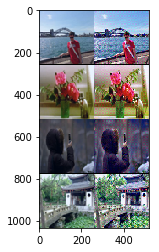

[Epoch 3/200] [Batch 4675/9375] [D loss: 0.000046] [G loss: 0.911771]


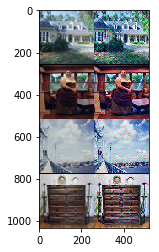

[Epoch 3/200] [Batch 4875/9375] [D loss: 0.000067] [G loss: 0.766338]


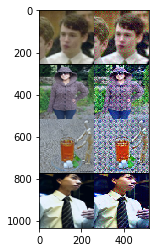

[Epoch 3/200] [Batch 5075/9375] [D loss: 0.000050] [G loss: 0.750660]


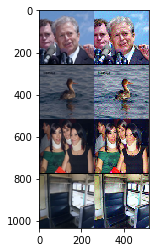

[Epoch 3/200] [Batch 5275/9375] [D loss: 0.000066] [G loss: 0.792899]


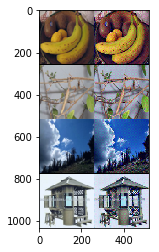

[Epoch 3/200] [Batch 5475/9375] [D loss: 0.000047] [G loss: 0.835043]


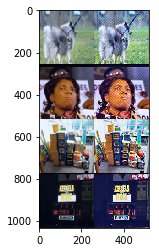

[Epoch 3/200] [Batch 5675/9375] [D loss: 0.000053] [G loss: 0.934951]


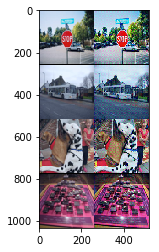

[Epoch 3/200] [Batch 5875/9375] [D loss: 0.000017] [G loss: 1.033623]


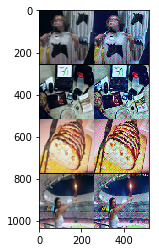

[Epoch 3/200] [Batch 6075/9375] [D loss: 0.000018] [G loss: 0.844935]


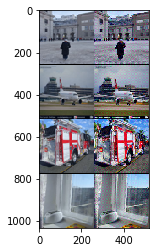

[Epoch 3/200] [Batch 6275/9375] [D loss: 0.000035] [G loss: 0.902665]


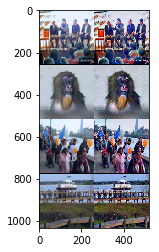

[Epoch 3/200] [Batch 6475/9375] [D loss: 0.000097] [G loss: 0.873772]


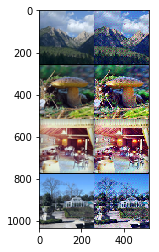

[Epoch 3/200] [Batch 6675/9375] [D loss: 0.000057] [G loss: 0.995641]


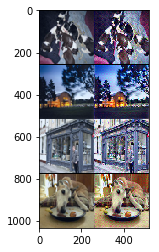

[Epoch 3/200] [Batch 6875/9375] [D loss: 0.000026] [G loss: 0.907014]


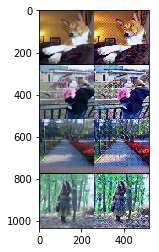

[Epoch 3/200] [Batch 7075/9375] [D loss: 0.000043] [G loss: 0.720507]


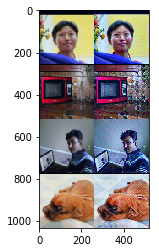

[Epoch 3/200] [Batch 7275/9375] [D loss: 0.000013] [G loss: 0.736874]


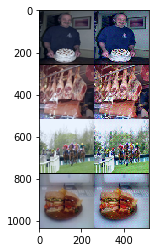

[Epoch 3/200] [Batch 7475/9375] [D loss: 0.000011] [G loss: 0.912403]


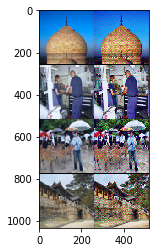

[Epoch 3/200] [Batch 7675/9375] [D loss: 0.000037] [G loss: 0.784941]


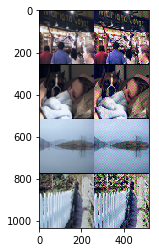

[Epoch 3/200] [Batch 7875/9375] [D loss: 0.000025] [G loss: 0.557833]


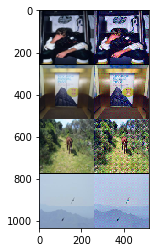

[Epoch 3/200] [Batch 8075/9375] [D loss: 0.000031] [G loss: 0.945940]


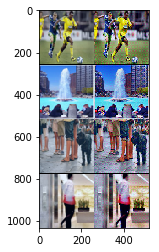

[Epoch 3/200] [Batch 8275/9375] [D loss: 0.000082] [G loss: 0.851100]


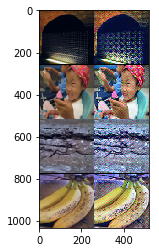

[Epoch 3/200] [Batch 8475/9375] [D loss: 0.000145] [G loss: 0.960829]


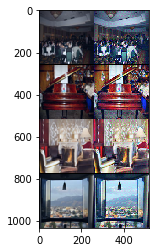

[Epoch 3/200] [Batch 8675/9375] [D loss: 0.000109] [G loss: 0.868654]


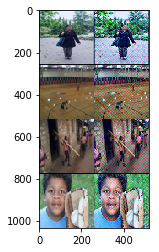

[Epoch 3/200] [Batch 8875/9375] [D loss: 0.000057] [G loss: 0.834759]


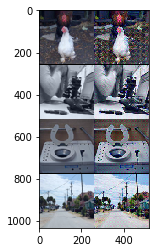

[Epoch 3/200] [Batch 9075/9375] [D loss: 0.000162] [G loss: 0.891661]


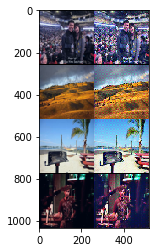

[Epoch 3/200] [Batch 9275/9375] [D loss: 0.000382] [G loss: 0.635088]


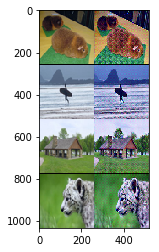

[Epoch 4/200] [Batch 100/9375] [D loss: 0.000033] [G loss: 0.891791]


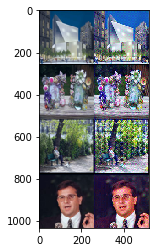

[Epoch 4/200] [Batch 300/9375] [D loss: 0.000014] [G loss: 1.073654]


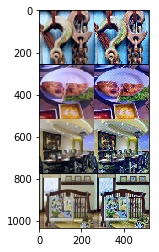

[Epoch 4/200] [Batch 500/9375] [D loss: 0.000046] [G loss: 0.780600]


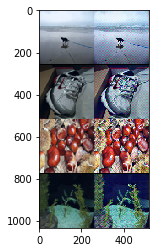

[Epoch 4/200] [Batch 700/9375] [D loss: 0.000148] [G loss: 0.843381]


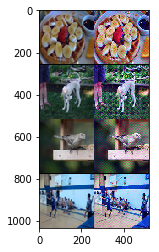

[Epoch 4/200] [Batch 900/9375] [D loss: 0.000035] [G loss: 0.937475]


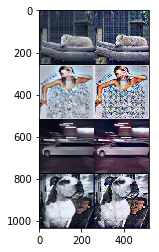

[Epoch 4/200] [Batch 1100/9375] [D loss: 0.000103] [G loss: 0.834768]


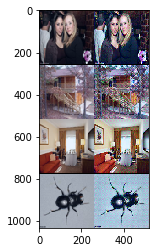

[Epoch 4/200] [Batch 1300/9375] [D loss: 0.000051] [G loss: 0.745910]


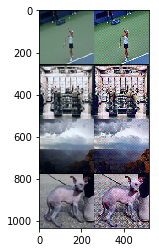

[Epoch 4/200] [Batch 1500/9375] [D loss: 0.000032] [G loss: 0.823856]


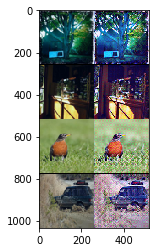

[Epoch 4/200] [Batch 1700/9375] [D loss: 0.000033] [G loss: 0.931259]


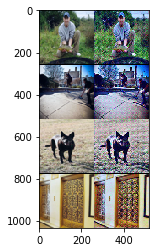

[Epoch 4/200] [Batch 1900/9375] [D loss: 0.000070] [G loss: 0.872260]


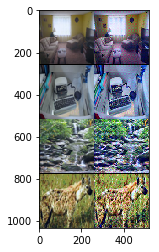

[Epoch 4/200] [Batch 2100/9375] [D loss: 0.000064] [G loss: 0.978330]


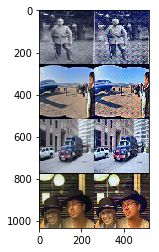

[Epoch 4/200] [Batch 2300/9375] [D loss: 0.000089] [G loss: 0.928190]


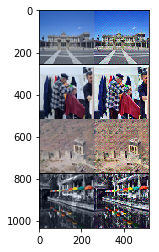

[Epoch 4/200] [Batch 2500/9375] [D loss: 0.000037] [G loss: 0.993863]


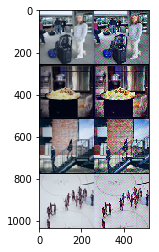

[Epoch 4/200] [Batch 2700/9375] [D loss: 0.000138] [G loss: 0.628828]


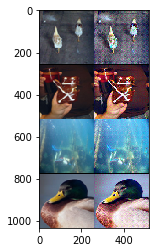

[Epoch 4/200] [Batch 2900/9375] [D loss: 0.000059] [G loss: 0.884851]


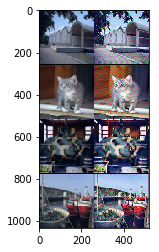

[Epoch 4/200] [Batch 3100/9375] [D loss: 0.000054] [G loss: 0.784804]


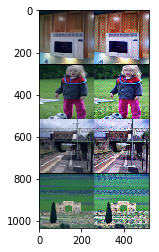

[Epoch 4/200] [Batch 3300/9375] [D loss: 0.000018] [G loss: 0.709357]


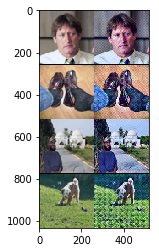

[Epoch 4/200] [Batch 3500/9375] [D loss: 0.000055] [G loss: 0.855875]


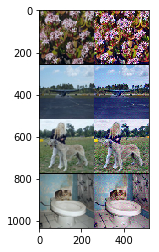

[Epoch 4/200] [Batch 3700/9375] [D loss: 0.000035] [G loss: 0.923980]


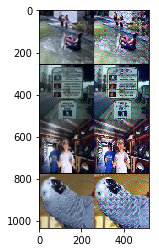

[Epoch 4/200] [Batch 3900/9375] [D loss: 0.000011] [G loss: 0.964515]


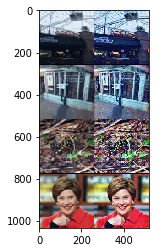

[Epoch 4/200] [Batch 4100/9375] [D loss: 0.000054] [G loss: 0.728859]


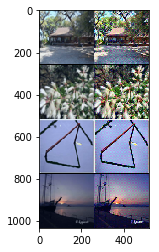

[Epoch 4/200] [Batch 4300/9375] [D loss: 0.000117] [G loss: 0.913888]


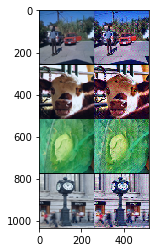

[Epoch 4/200] [Batch 4500/9375] [D loss: 0.000035] [G loss: 0.925493]


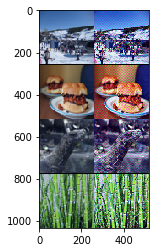

[Epoch 4/200] [Batch 4700/9375] [D loss: 0.000043] [G loss: 0.887298]


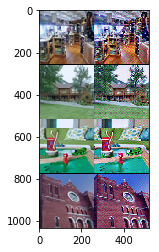

[Epoch 4/200] [Batch 4900/9375] [D loss: 0.000030] [G loss: 0.759349]


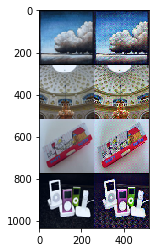

[Epoch 4/200] [Batch 5100/9375] [D loss: 0.000024] [G loss: 0.866732]


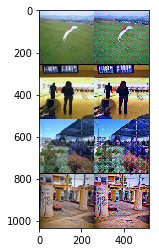

[Epoch 4/200] [Batch 5300/9375] [D loss: 0.000027] [G loss: 0.844328]


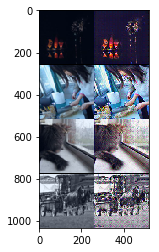

[Epoch 4/200] [Batch 5500/9375] [D loss: 0.000006] [G loss: 0.874535]


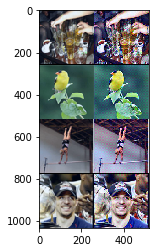

[Epoch 4/200] [Batch 5700/9375] [D loss: 0.000027] [G loss: 0.576650]


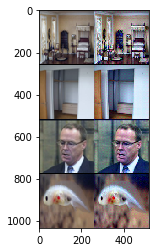

[Epoch 4/200] [Batch 5900/9375] [D loss: 0.000025] [G loss: 0.519344]


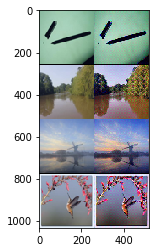

[Epoch 4/200] [Batch 6100/9375] [D loss: 0.000038] [G loss: 0.853292]


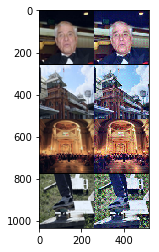

[Epoch 4/200] [Batch 6300/9375] [D loss: 0.000044] [G loss: 0.815845]


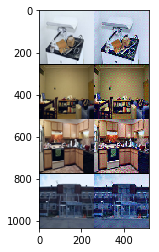

[Epoch 4/200] [Batch 6500/9375] [D loss: 0.000066] [G loss: 0.847391]


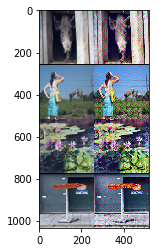

[Epoch 4/200] [Batch 6700/9375] [D loss: 0.000138] [G loss: 0.585131]


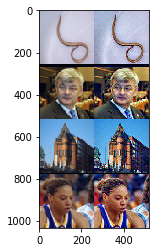

[Epoch 4/200] [Batch 6900/9375] [D loss: 0.000093] [G loss: 0.916147]


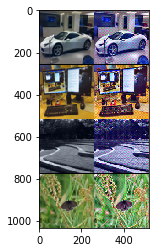

[Epoch 4/200] [Batch 7100/9375] [D loss: 0.000065] [G loss: 0.873291]


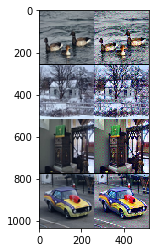

[Epoch 4/200] [Batch 7300/9375] [D loss: 0.000045] [G loss: 0.906223]


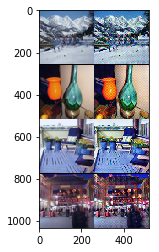

[Epoch 4/200] [Batch 7500/9375] [D loss: 0.000009] [G loss: 1.142684]


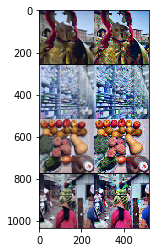

[Epoch 4/200] [Batch 7700/9375] [D loss: 0.000047] [G loss: 0.862801]


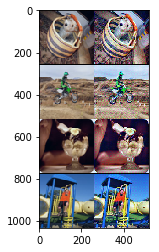

[Epoch 4/200] [Batch 7900/9375] [D loss: 0.000012] [G loss: 0.632195]


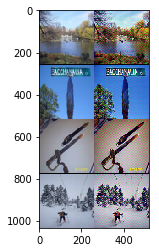

[Epoch 4/200] [Batch 8100/9375] [D loss: 0.000006] [G loss: 0.709702]


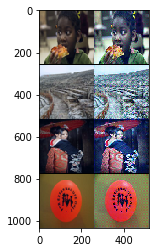

[Epoch 4/200] [Batch 8300/9375] [D loss: 0.000014] [G loss: 0.862558]


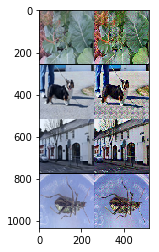

[Epoch 4/200] [Batch 8500/9375] [D loss: 0.000085] [G loss: 0.936383]


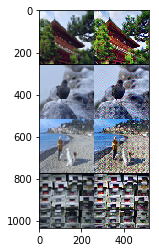

[Epoch 4/200] [Batch 8700/9375] [D loss: 0.000013] [G loss: 0.829585]


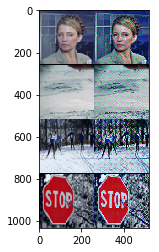

[Epoch 4/200] [Batch 8900/9375] [D loss: 0.000031] [G loss: 0.795578]


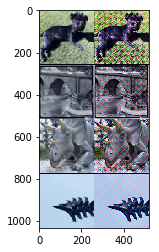

[Epoch 4/200] [Batch 9100/9375] [D loss: 0.000055] [G loss: 0.791362]


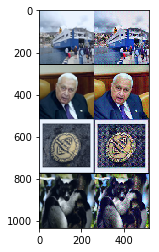

[Epoch 4/200] [Batch 9300/9375] [D loss: 0.000021] [G loss: 0.653630]


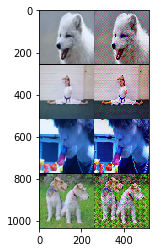

[Epoch 5/200] [Batch 125/9375] [D loss: 0.000101] [G loss: 0.940843]


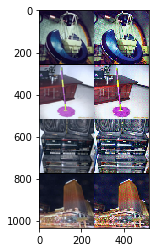

[Epoch 5/200] [Batch 325/9375] [D loss: 0.000022] [G loss: 1.026214]


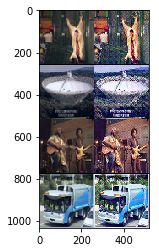

[Epoch 5/200] [Batch 525/9375] [D loss: 0.000056] [G loss: 0.772790]


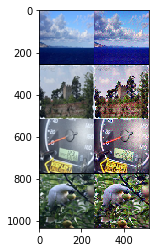

[Epoch 5/200] [Batch 725/9375] [D loss: 0.000064] [G loss: 0.653343]


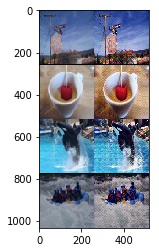

[Epoch 5/200] [Batch 925/9375] [D loss: 0.000012] [G loss: 0.797305]


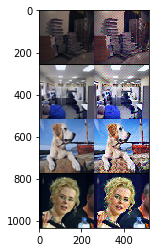

[Epoch 5/200] [Batch 1125/9375] [D loss: 0.000036] [G loss: 1.027269]


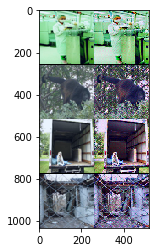

[Epoch 5/200] [Batch 1325/9375] [D loss: 0.000019] [G loss: 0.985465]


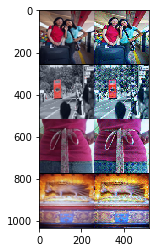

[Epoch 5/200] [Batch 1525/9375] [D loss: 0.000045] [G loss: 0.655564]


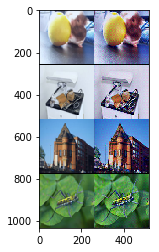

[Epoch 5/200] [Batch 1725/9375] [D loss: 0.000026] [G loss: 0.850406]


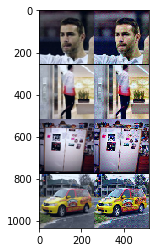

[Epoch 5/200] [Batch 1925/9375] [D loss: 0.000033] [G loss: 0.845634]


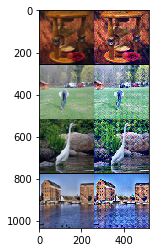

[Epoch 5/200] [Batch 2125/9375] [D loss: 0.000011] [G loss: 0.716737]


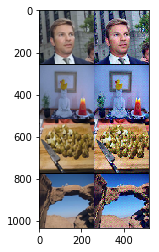

[Epoch 5/200] [Batch 2325/9375] [D loss: 0.000185] [G loss: 0.599347]


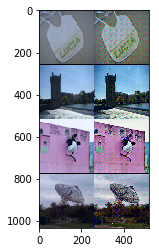

[Epoch 5/200] [Batch 2525/9375] [D loss: 0.000046] [G loss: 0.700397]


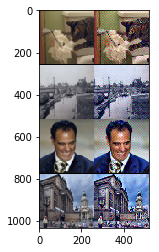

[Epoch 5/200] [Batch 2725/9375] [D loss: 0.000024] [G loss: 1.025583]


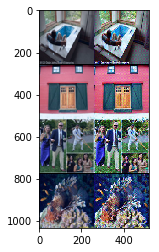

[Epoch 5/200] [Batch 2925/9375] [D loss: 0.000099] [G loss: 0.741222]


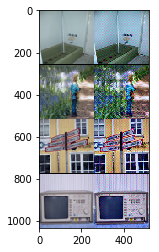

[Epoch 5/200] [Batch 3125/9375] [D loss: 0.000022] [G loss: 0.699163]


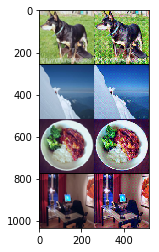

[Epoch 5/200] [Batch 3325/9375] [D loss: 0.000041] [G loss: 0.713827]


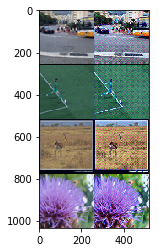

[Epoch 5/200] [Batch 3525/9375] [D loss: 0.000015] [G loss: 0.722203]


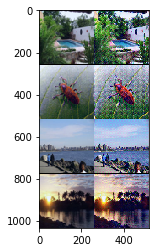

[Epoch 5/200] [Batch 3725/9375] [D loss: 0.000030] [G loss: 0.913532]


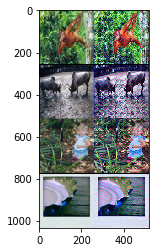

[Epoch 5/200] [Batch 3925/9375] [D loss: 0.000064] [G loss: 0.702058]


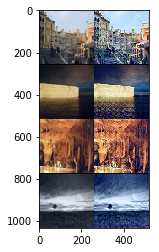

[Epoch 5/200] [Batch 4125/9375] [D loss: 0.000009] [G loss: 0.764872]


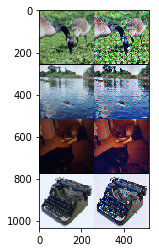

[Epoch 5/200] [Batch 4325/9375] [D loss: 0.000037] [G loss: 0.619908]


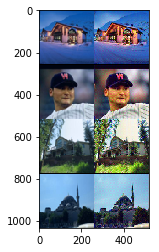

[Epoch 5/200] [Batch 4525/9375] [D loss: 0.000091] [G loss: 0.837452]


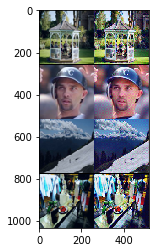

[Epoch 5/200] [Batch 4725/9375] [D loss: 0.000082] [G loss: 0.764820]


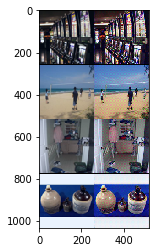

[Epoch 5/200] [Batch 4925/9375] [D loss: 0.000013] [G loss: 0.678661]


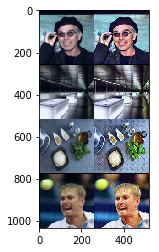

[Epoch 5/200] [Batch 5125/9375] [D loss: 0.000016] [G loss: 0.920121]


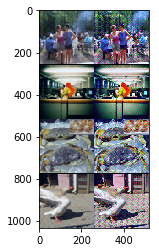

[Epoch 5/200] [Batch 5325/9375] [D loss: 0.000017] [G loss: 0.835429]


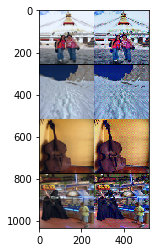

[Epoch 5/200] [Batch 5525/9375] [D loss: 0.000022] [G loss: 0.711647]


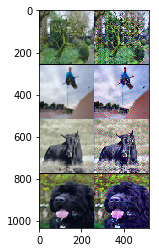

[Epoch 5/200] [Batch 5725/9375] [D loss: 0.000006] [G loss: 0.677271]


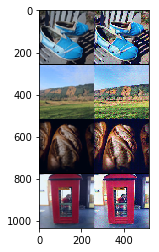

[Epoch 5/200] [Batch 5925/9375] [D loss: 0.000040] [G loss: 0.764679]


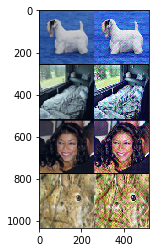

[Epoch 5/200] [Batch 6125/9375] [D loss: 0.000030] [G loss: 0.736425]


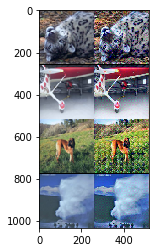

[Epoch 5/200] [Batch 6325/9375] [D loss: 0.000028] [G loss: 0.759783]


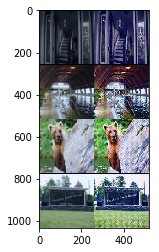

[Epoch 5/200] [Batch 6525/9375] [D loss: 0.000016] [G loss: 0.749620]


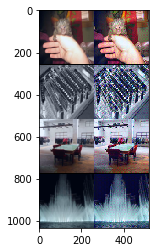

[Epoch 5/200] [Batch 6725/9375] [D loss: 0.000037] [G loss: 0.640899]


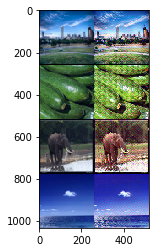

[Epoch 5/200] [Batch 6925/9375] [D loss: 0.000020] [G loss: 0.684155]


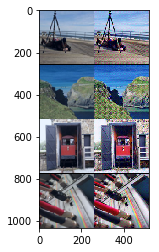

[Epoch 5/200] [Batch 7125/9375] [D loss: 0.000004] [G loss: 0.661257]


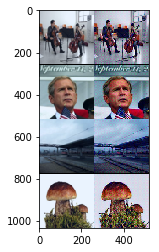

[Epoch 5/200] [Batch 7325/9375] [D loss: 0.000045] [G loss: 1.090436]


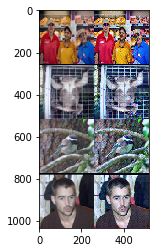

[Epoch 5/200] [Batch 7525/9375] [D loss: 0.000010] [G loss: 0.688785]


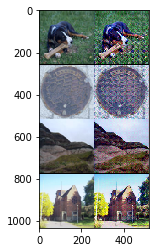

[Epoch 5/200] [Batch 7725/9375] [D loss: 0.000031] [G loss: 0.797963]


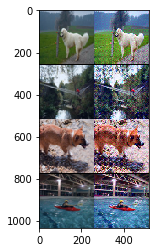

[Epoch 5/200] [Batch 7925/9375] [D loss: 0.000029] [G loss: 0.784460]


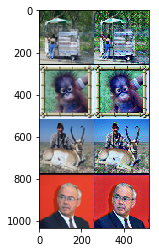

[Epoch 5/200] [Batch 8125/9375] [D loss: 0.000014] [G loss: 0.827962]


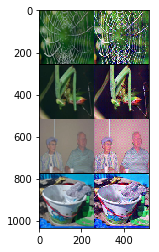

[Epoch 5/200] [Batch 8325/9375] [D loss: 0.000003] [G loss: 0.831562]


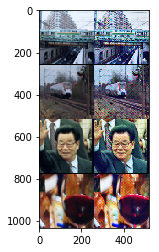

[Epoch 5/200] [Batch 8525/9375] [D loss: 0.000005] [G loss: 0.792348]


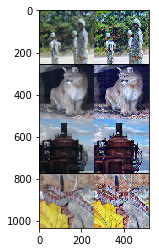

[Epoch 5/200] [Batch 8725/9375] [D loss: 0.000031] [G loss: 1.030457]


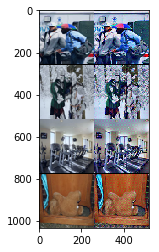

[Epoch 5/200] [Batch 8925/9375] [D loss: 0.000015] [G loss: 0.806362]


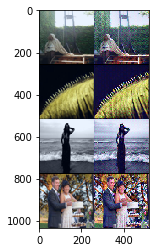

[Epoch 5/200] [Batch 9125/9375] [D loss: 0.000125] [G loss: 0.696591]


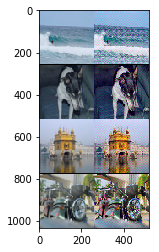

[Epoch 5/200] [Batch 9325/9375] [D loss: 0.000030] [G loss: 0.899719]


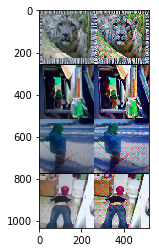

[Epoch 6/200] [Batch 150/9375] [D loss: 0.000008] [G loss: 0.965514]


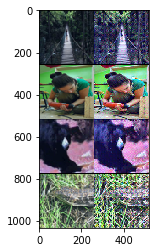

[Epoch 6/200] [Batch 350/9375] [D loss: 0.000035] [G loss: 0.931574]


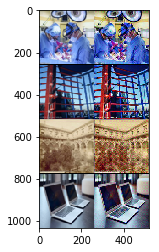

[Epoch 6/200] [Batch 550/9375] [D loss: 0.000022] [G loss: 0.841510]


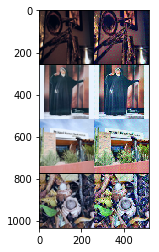

[Epoch 6/200] [Batch 750/9375] [D loss: 0.000024] [G loss: 0.687175]


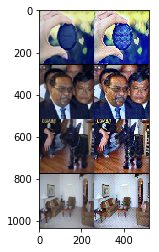

[Epoch 6/200] [Batch 950/9375] [D loss: 0.000057] [G loss: 0.994883]


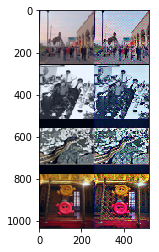

[Epoch 6/200] [Batch 1150/9375] [D loss: 0.000005] [G loss: 0.684362]


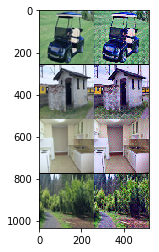

[Epoch 6/200] [Batch 1350/9375] [D loss: 0.000004] [G loss: 0.770196]


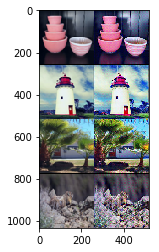

[Epoch 6/200] [Batch 1550/9375] [D loss: 0.000007] [G loss: 0.879650]


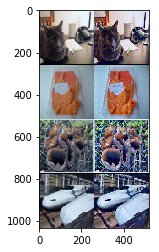

[Epoch 6/200] [Batch 1750/9375] [D loss: 0.000007] [G loss: 0.692468]


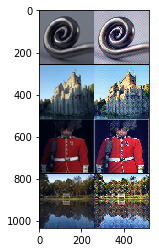

[Epoch 6/200] [Batch 1950/9375] [D loss: 0.000023] [G loss: 0.724334]


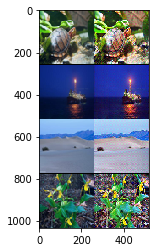

[Epoch 6/200] [Batch 2150/9375] [D loss: 0.000035] [G loss: 0.871669]


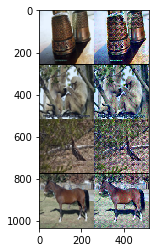

[Epoch 6/200] [Batch 2350/9375] [D loss: 0.000023] [G loss: 0.819716]


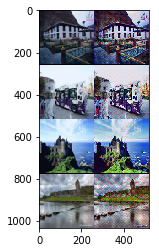

[Epoch 6/200] [Batch 2550/9375] [D loss: 0.000005] [G loss: 0.868298]


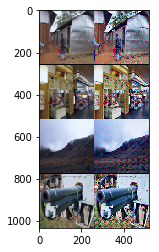

[Epoch 6/200] [Batch 2750/9375] [D loss: 0.000018] [G loss: 0.782004]


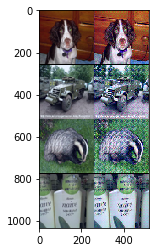

[Epoch 6/200] [Batch 2950/9375] [D loss: 0.000010] [G loss: 0.917837]


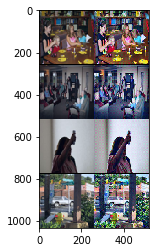

[Epoch 6/200] [Batch 3150/9375] [D loss: 0.000006] [G loss: 0.753923]


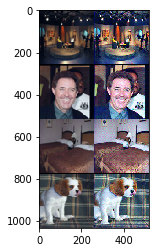

[Epoch 6/200] [Batch 3350/9375] [D loss: 0.000019] [G loss: 0.824497]


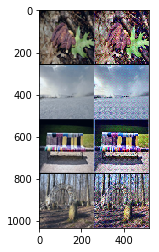

Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/queues.py", line 240, in _feed
    send_bytes(obj)
Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/queues.py", line 240, in _feed
    send_bytes(obj)
Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/queues.py", line 240, in _feed
    send_bytes(obj)
  File "/usr/lib/python3.6/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/usr/lib/python3.6/multiprocessing/connection.py", line 404, in _send_bytes
    self._send(header + buf)
  File "/usr/lib/python3.6/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/usr/lib/python3.6/multiprocessing/connection.py", line 404, in _send_bytes
    self._send(header + buf)
  File "/usr/lib/python3.6/multiprocessing/connection.py", line 368, in _send
    n = write(self._handle, buf)
Traceback (most re

KeyboardInterrupt: ignored

In [0]:
# ----------
#  Training
# ----------

for epoch in range(epochs):
    for i, imgs in enumerate(dataloader):

        # Configure model input
        imgs_lr = Variable(imgs["lr"].type(Tensor))
        imgs_hr = Variable(imgs["hr"].type(Tensor))

        # Adversarial ground truths
        valid = Variable(Tensor(np.ones((imgs_lr.size(0), *discriminator.output_shape))), requires_grad=False)
        fake = Variable(Tensor(np.zeros((imgs_lr.size(0), *discriminator.output_shape))), requires_grad=False)

        # ------------------
        #  Train Generators
        # ------------------

        optimizer_G.zero_grad()

        # Generate a high resolution image from low resolution input
        gen_hr = generator(imgs_lr)

        # Adversarial loss
        loss_GAN = criterion_GAN(discriminator(gen_hr), valid)

        # Content loss
        gen_features = feature_extractor(gen_hr)
        real_features = feature_extractor(imgs_hr)
        loss_content = criterion_content(gen_features, real_features.detach())

        # Total loss
        loss_G = loss_content + 1e-3 * loss_GAN

        loss_G.backward()
        optimizer_G.step()

        # ---------------------
        #  Train Discriminator
        # ---------------------

        optimizer_D.zero_grad()

        # Loss of real and fake images
        loss_real = criterion_GAN(discriminator(imgs_hr), valid)
        loss_fake = criterion_GAN(discriminator(gen_hr.detach()), fake)

        # Total loss
        loss_D = (loss_real + loss_fake) / 2

        loss_D.backward()
        optimizer_D.step()

        # --------------
        #  Log Progress
        # --------------

  
        batches_done = epoch * len(dataloader) + i
        if batches_done % 200 == 0:
            sys.stdout.write(
            "[Epoch %d/%d] [Batch %d/%d] [D loss: %f] [G loss: %f]\n"
            % (epoch, epochs, i, len(dataloader), loss_D.item(), loss_G.item())
        )

            # Save image grid with upsampled inputs and SRGAN outputs
            imgs_lr = nn.functional.interpolate(imgs_lr, scale_factor=4)
            gen_hr = make_grid(gen_hr, nrow=1, normalize=True)
            imgs_lr = make_grid(imgs_lr, nrow=1, normalize=True)
            img_grid = torch.cat((imgs_lr, gen_hr), -1)
            import matplotlib.pyplot as plt
            image = np.moveaxis(img_grid.detach().cpu().numpy(),0,-1)
            plt.imshow(image)
            plt.show()
             
    if epoch % checkpoint_interval == 0:
        # Save model checkpoints
        torch.save(generator.state_dict(), "/content/drive/My Drive/DL_Seminar/ckpts/generator_%d.pth" % epoch)
        torch.save(discriminator.state_dict(), "/content/drive/My Drive/DL_Seminar/ckpts/discriminator_%d.pth" % epoch)
